In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
from matplotlib import pyplot as plt
import sqlite3
from mpl_toolkits.basemap import Basemap
from IPython.display import display, HTML

## Goals

The Goal of this EDA is to understand California Traffic Collision Data in details.
Since the dataset is really large, we will aim to introduce various transformations and filter columns which are carrying sensible informations.

Since each traffic accident can be dangerous, we will try to understand if it is possible to use this dataset to predict if accident was fatal from the raw dataset.


To achieve that first we need to get acquinted with the Dataset:


In [2]:
con = sqlite3.connect("./data/switrs.sqlite")

cur = con.cursor()

In [3]:
res = cur.execute("SELECT name FROM sqlite_master WHERE type='table'")
tables = [r[0] for r in res.fetchall()]
# Print available tables:
print("Tables: ", tables)

Tables:  ['case_ids', 'collisions', 'victims', 'parties']


Let's try to visualize location frequency of these accidents in California map.

We will introduce also a killed_victims heatmap so we can spot any patterns which may be obvious.


In [4]:
query = (
    "SELECT latitude, longitude, killed_victims "
    "FROM collisions "
    "WHERE latitude IS NOT NULL AND longitude IS NOT NULL AND strftime('%Y',collision_date) = '2019'"
)
map_df = pd.read_sql_query(query, con)

Since data is too large to be loaded into openStreet map, we are using data from 2019:


In [5]:
print(map_df.head())

map_df.info()

   latitude  longitude  killed_victims
0  35.51429 -119.26035               0
1  35.37000 -119.00250               0
2  35.29605 -119.07480               0
3  35.29587 -119.02170               0
4  35.30960 -119.04020               0
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 301702 entries, 0 to 301701
Data columns (total 3 columns):
 #   Column          Non-Null Count   Dtype  
---  ------          --------------   -----  
 0   latitude        301702 non-null  float64
 1   longitude       301702 non-null  float64
 2   killed_victims  301702 non-null  int64  
dtypes: float64(2), int64(1)
memory usage: 6.9 MB


In [6]:
import plotly.express as px

color_scale = [(0, "orange"), (1, "red")]
fig = px.scatter_mapbox(
    map_df,
    lat="latitude",
    lon="longitude",
    hover_name="killed_victims",
    zoom=4.5,
    height=400,
    width=800,
    color="killed_victims",
    color_continuous_scale=color_scale,
    size="killed_victims",
    title="Location of coliisions in 2019",
)
fig.update_layout(mapbox_style="open-street-map")
fig.show()
del map_df

Let's explore collision data, notably how the data relates to time:


In [7]:
query = "SELECT * FROM collisions order by RANDOM() LIMIT 1000"
col_df = pd.read_sql_query(query, con)

In [8]:
print(col_df.columns)
display(HTML(col_df.head().to_html()))

Index(['case_id', 'jurisdiction', 'officer_id', 'reporting_district',
       'chp_shift', 'population', 'county_city_location', 'special_condition',
       'beat_type', 'chp_beat_type', 'city_division_lapd', 'chp_beat_class',
       'beat_number', 'primary_road', 'secondary_road', 'distance',
       'direction', 'intersection', 'weather_1', 'weather_2',
       'state_highway_indicator', 'caltrans_county', 'caltrans_district',
       'state_route', 'route_suffix', 'postmile_prefix', 'postmile',
       'location_type', 'ramp_intersection', 'side_of_highway', 'tow_away',
       'collision_severity', 'killed_victims', 'injured_victims',
       'party_count', 'primary_collision_factor', 'pcf_violation_code',
       'pcf_violation_category', 'pcf_violation', 'pcf_violation_subsection',
       'hit_and_run', 'type_of_collision', 'motor_vehicle_involved_with',
       'pedestrian_action', 'road_surface', 'road_condition_1',
       'road_condition_2', 'lighting', 'control_device', 'chp_road_type

,case_id,jurisdiction,officer_id,reporting_district,chp_shift,population,county_city_location,special_condition,beat_type,chp_beat_type,city_division_lapd,chp_beat_class,beat_number,primary_road,secondary_road,distance,direction,intersection,weather_1,weather_2,state_highway_indicator,caltrans_county,caltrans_district,state_route,route_suffix,postmile_prefix,postmile,location_type,ramp_intersection,side_of_highway,tow_away,collision_severity,killed_victims,injured_victims,party_count,primary_collision_factor,pcf_violation_code,pcf_violation_category,pcf_violation,pcf_violation_subsection,hit_and_run,type_of_collision,motor_vehicle_involved_with,pedestrian_action,road_surface,road_condition_1,road_condition_2,lighting,control_device,chp_road_type,pedestrian_collision,bicycle_collision,motorcycle_collision,truck_collision,not_private_property,alcohol_involved,statewide_vehicle_type_at_fault,chp_vehicle_type_at_fault,severe_injury_count,other_visible_injury_count,complaint_of_pain_injury_count,pedestrian_killed_count,pedestrian_injured_count,bicyclist_killed_count,bicyclist_injured_count,motorcyclist_killed_count,motorcyclist_injured_count,primary_ramp,secondary_ramp,latitude,longitude,collision_date,collision_time,process_date
0,8690962,5406.0,30,5C,5,4,5406,0,0,not chp,None,not chp,0AO,BARDSLEY,NELDER GROVE,0.0,None,1.0,clear,None,0,None,NaN,NaN,None,None,NaN,None,NaN,None,1.0,pain,0,1,2,vehicle code violation,None,improper passing,21755.0,A,not hit and run,head-on,other motor vehicle,no pedestrian involved,dry,normal,None,daylight,functioning,0,NaN,NaN,NaN,NaN,1,NaN,passenger car,07,0,0,1,0,0,0,0,0,0,None,None,NaN,NaN,2018-08-13,08:12:00,2018-09-28
1,90654502,9535.0,019540,None,2,9,1900,0,3,county road area,None,chp other,002,LA VERNE AVE (600 BLOCK),6TH ST,112.0,south,0.0,clear,None,0,None,NaN,NaN,None,None,NaN,None,NaN,None,0.0,property damage only,0,0,2,vehicle code violation,None,unsafe starting or backing,22106.0,None,not hit and run,other,parked motor vehicle,no pedestrian involved,dry,normal,None,dark with street lights,none,0,NaN,NaN,NaN,NaN,1,NaN,passenger car,01,0,0,0,0,0,0,0,0,0,None,None,34.02554,-118.16091,2018-01-28,20:07:00,2018-02-05
2,90743279,9835.0,016683,None,3,9,3600,0,1,interstate,None,chp other,047,I-40 W/B,KELBAKER RD,32525.0,west,0.0,clear,None,1,None,NaN,NaN,None,None,NaN,None,NaN,None,1.0,other injury,0,1,1,vehicle code violation,None,improper turning,22107.0,None,not hit and run,overturned,non-collision,no pedestrian involved,dry,normal,None,dusk or dawn,none,0,NaN,NaN,NaN,1.0,1,NaN,truck or truck tractor with trailer,25,0,1,0,0,0,0,0,0,0,None,None,34.71794,-115.77307,2018-05-29,04:50:00,2018-06-07
3,0186533,9250.0,11179,None,2,9,3400,0,2,county road line,None,chp primary,031,SUNRISE BL,WINDING WY,150.0,south,0.0,None,None,0,None,NaN,NaN,None,None,NaN,None,NaN,None,0.0,property damage only,0,0,2,vehicle code violation,None,unsafe starting or backing,22106.0,None,not hit and run,other,other motor vehicle,no pedestrian involved,None,None,None,None,functioning,0,NaN,NaN,NaN,1.0,1,NaN,None,None,0,0,0,0,0,0,0,0,0,None,None,NaN,NaN,2002-04-25,18:30:00,2002-09-11
4,1942010420012527792,1942.0,27792,969,5,7,1942,None,0,not chp,I,not chp,None,OXNARD,COLDWATER CYN,350.0,west,0.0,clear,None,0,None,0.0,0.0,None,None,0.0,None,8.0,None,1.0,other injury,0,2,2,vehicle code violation,vehicle,following too closely,21703.0,None,not hit and run,rear end,other motor vehicle,no pedestrian involved,dry,normal,None,dark with street lights,none,0,NaN,NaN,NaN,NaN,1,NaN,passenger car,00,0,1,1,0,0,0,0,0,0,None,None,NaN,NaN,2001-04-20,01:25:00,2001-07-20


Here we are trying to observe number of accidents throughout years:


In [9]:
query = """SELECT SUM(killed_victims) AS no_casualties,
                  COUNT(CASE WHEN killed_victims=0 THEN killed_victims END) as zero_casualties,
                    strftime('%Y',collision_date) AS year 
                        FROM collisions 
                            group by strftime('%Y',collision_date)"""
killed_df = pd.read_sql_query(query, con)

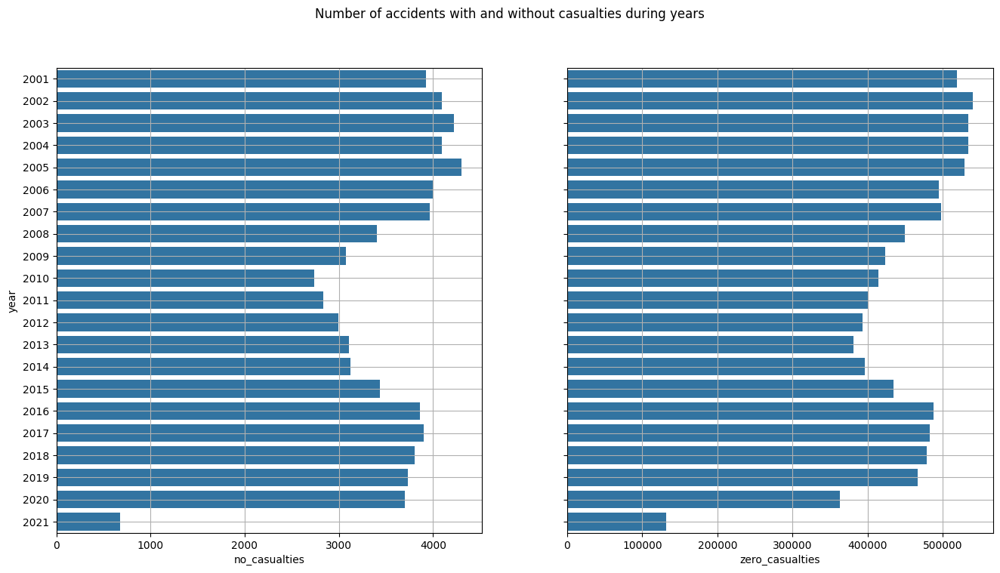

In [10]:
fig, (ax1, ax2) = plt.subplots(ncols=2, sharey=True)
fig.set_size_inches(16, 8)
sns.barplot(data=killed_df, y="year", x="no_casualties", ax=ax1)
sns.barplot(data=killed_df, y="year", x="zero_casualties", ax=ax2)
ax1.grid()
ax2.grid()
fig.suptitle("Number of accidents with and without casualties during years")
plt.show()

In this case, we are observing frequency of accidents during a hours in a day:


In [11]:
query = """SELECT CASE WHEN killed_victims=0 THEN 0 ELSE 1  END as is_fatal,
                    strftime('%H',collision_time) AS hour 
                        FROM collisions order by hour asc """
killed_df = pd.read_sql_query(query, con)

In [12]:
# it is pretty skewed towards single value:
killed_df["is_fatal"].value_counts()

is_fatal
0    9355860
1      68474
Name: count, dtype: int64

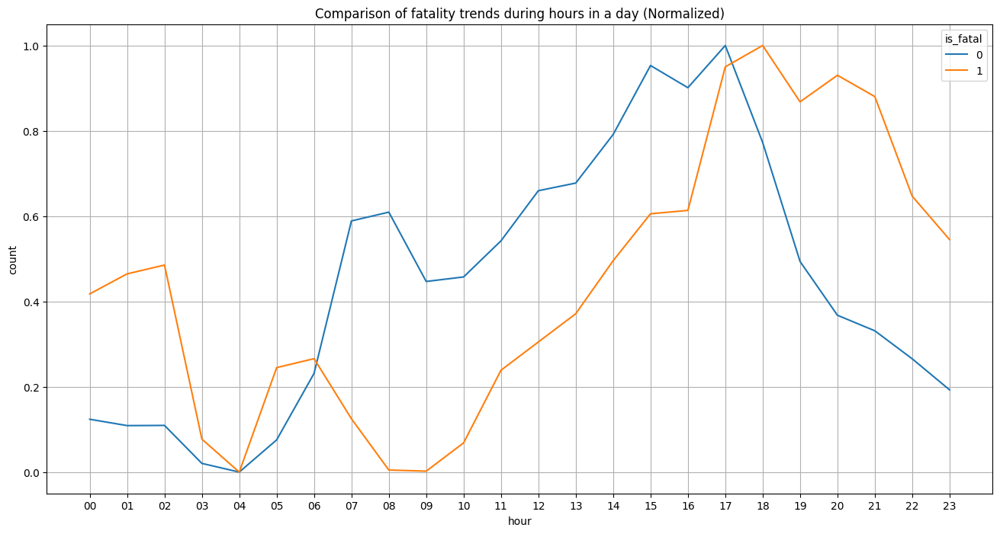

In [13]:
# Normalizing between 0 and 1  (min/max scaler)
temp_data = killed_df.groupby(["hour", "is_fatal"]).size().reset_index()
temp_data["count"] = None
plt.rcParams["figure.figsize"] = (16, 8)
temp_scaler = temp_data[temp_data["is_fatal"] == 0][0].copy()
temp = (temp_scaler - temp_scaler.min()) / (temp_scaler.max() - temp_scaler.min())
temp_data.loc[temp.index, "count"] = temp.values
temp_scaler = temp_data[temp_data["is_fatal"] == 1][0].copy()
temp = (temp_scaler - temp_scaler.min()) / (temp_scaler.max() - temp_scaler.min())
temp_data.loc[temp.index, "count"] = temp.values
sns.lineplot(data=temp_data, x="hour", y="count", hue="is_fatal", markers=True)
plt.grid()
plt.title("Comparison of fatality trends during hours in a day (Normalized)")
plt.show()
del temp_data

How does victim's degree of injury relate with collisions?


In [14]:
# Distribution of the number of accidents per each day of the week
query = """ 
SELECT collisions.case_id,collisions.collision_date,victims.victim_degree_of_injury
     FROM collisions 
     INNER JOIN victims on collisions.case_id = victims.case_id 
          INNER JOIN parties on collisions.case_id=parties.case_id 
          order by RANDOM() LIMIT 1000
"""
df = pd.read_sql_query(query, con)
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 3 columns):
 #   Column                   Non-Null Count  Dtype 
---  ------                   --------------  ----- 
 0   case_id                  1000 non-null   object
 1   collision_date           1000 non-null   object
 2   victim_degree_of_injury  1000 non-null   object
dtypes: object(3)
memory usage: 23.6+ KB


In [15]:
df.collision_date = pd.to_datetime(df.collision_date)
df["weekday"] = df.collision_date.dt.weekday
df.groupby("victim_degree_of_injury")["weekday"].agg(pd.Series.mode)
df["victim_degree_of_injury"].value_counts()

victim_degree_of_injury
no injury               454
complaint of pain       359
other visible injury    116
7                        25
severe injury            25
6                        15
5                         4
killed                    2
Name: count, dtype: int64

What is the most frequent week day for accidents?


<Axes: xlabel='weekday', ylabel='Percent'>

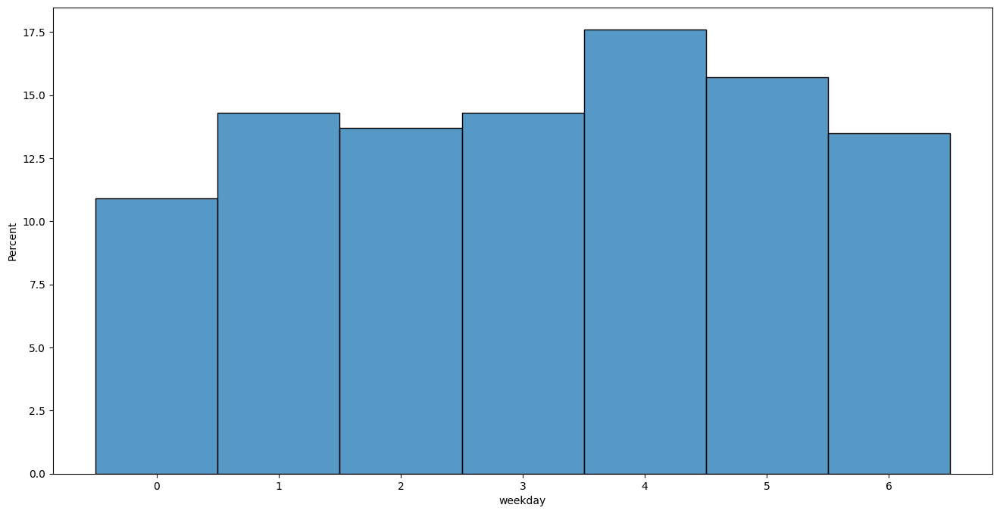

In [16]:
sns.histplot(data=df, x="weekday", discrete=True, stat="percent")

If we take into consideration the weekend trens ( Fri,Sat,Sun), we see that 42.2% of accidents happens on a weekend


In [17]:
print(len(df[(df["weekday"] > 4) | (df["weekday"] < 1)]["weekday"]) / len(df))
del df

0.401


In [18]:
#   Average age of drivers who were at fault that involves another motor-vehicle
query = """
        SELECT parties.party_age, 
                  parties.party_sex 
        from parties 
        JOIN collisions ON parties.case_id = collisions.case_id
        WHERE parties.at_fault = 1
            AND party_type = 'driver'
            AND collisions.motor_vehicle_involved_with  IN ('motor vehicle on other roadway', 'other motor vehicle')
            AND (COALESCE(party_age, party_sex) IS NOT NULL 
                OR COALESCE(party_age, party_sex) != '')
        
        """

table = pd.read_sql_query(query, con)

<Axes: xlabel='party_sex', ylabel='party_age'>

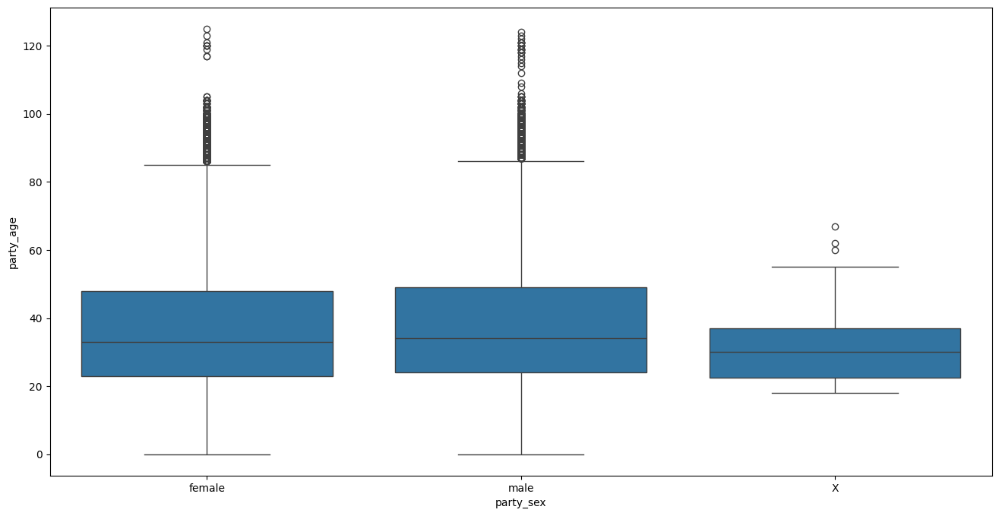

In [19]:
# Pretty similar here
sns.boxplot(data=table, x="party_sex", y="party_age")

Which type collisions causes most of fatal accidents?


In [20]:
data = pd.read_sql_query(
    "SELECT * FROM parties JOIN collisions USING (case_id) order by RANDOM() LIMIT 1000",
    con,
)

In [21]:
data.info()
data["at_fault"].value_counts()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Columns: 104 entries, id to process_date
dtypes: float64(19), int64(19), object(66)
memory usage: 812.6+ KB


at_fault
0    555
1    445
Name: count, dtype: int64

/tmp/ipykernel_150194/1479746187.py:11: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.





Text(0, 0.5, 'Percentages (%)')

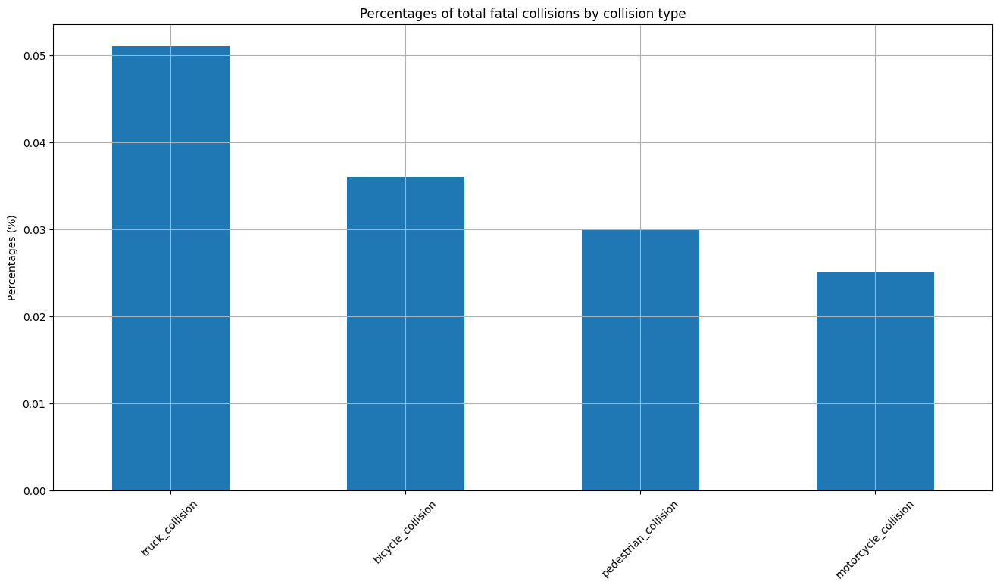

In [22]:
# Fill 'collision' null values with 0
df = data
collision_set = [
    "pedestrian_collision",
    "bicycle_collision",
    "motorcycle_collision",
    "truck_collision",
]

for i in collision_set:
    df[i].fillna(0, inplace=True)

# Show 'collision' columns
df[collision_set]
df[collision_set].mean().sort_values(ascending=False).plot(kind="bar")
plt.title("Percentages of total fatal collisions by collision type")
plt.xticks(rotation=45)
plt.grid()
plt.ylabel("Percentages (%)")

In [23]:
data[collision_set].info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 4 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   pedestrian_collision  1000 non-null   float64
 1   bicycle_collision     1000 non-null   float64
 2   motorcycle_collision  1000 non-null   float64
 3   truck_collision       1000 non-null   float64
dtypes: float64(4)
memory usage: 31.4 KB


What is the most significat age interval to participate in an accident?


Most frequent age of collision party that is at fault is: 19.0


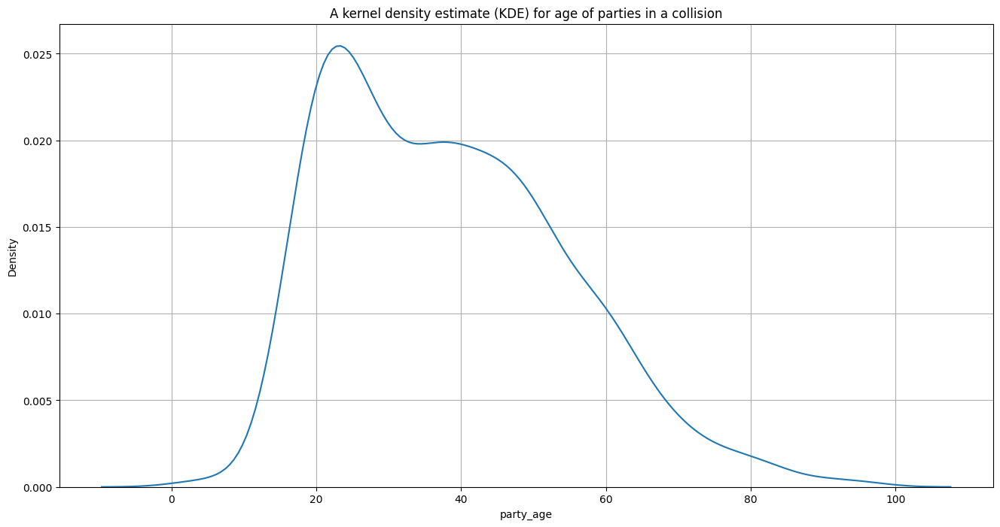

In [24]:
sns.kdeplot(data=data, x="party_age")
plt.grid()
plt.title("A kernel density estimate (KDE) for age of parties in a collision")
print(
    "Most frequent age of collision party that is at fault is:",
    data["party_age"].mode().to_list()[0],
)

How does alcohol relates to parties at fault in a collision?


In [25]:
column_name = "alcohol_involved"
value_to_replace = 0

data[column_name].fillna(value_to_replace, inplace=True)

data["alcohol_involved"] = data["alcohol_involved"].astype(np.int64)

value_count = value_count = data[column_name].value_counts()
null_value = data[column_name].isnull().sum()
print(value_count)
print("---------------------------")
print(f"null values in {column_name} : {null_value}")

alcohol_involved
0    906
1     94
Name: count, dtype: int64
---------------------------
null values in alcohol_involved : 0


/tmp/ipykernel_150194/3549595352.py:4: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.





<Axes: xlabel='alcohol_involved', ylabel='Percent'>

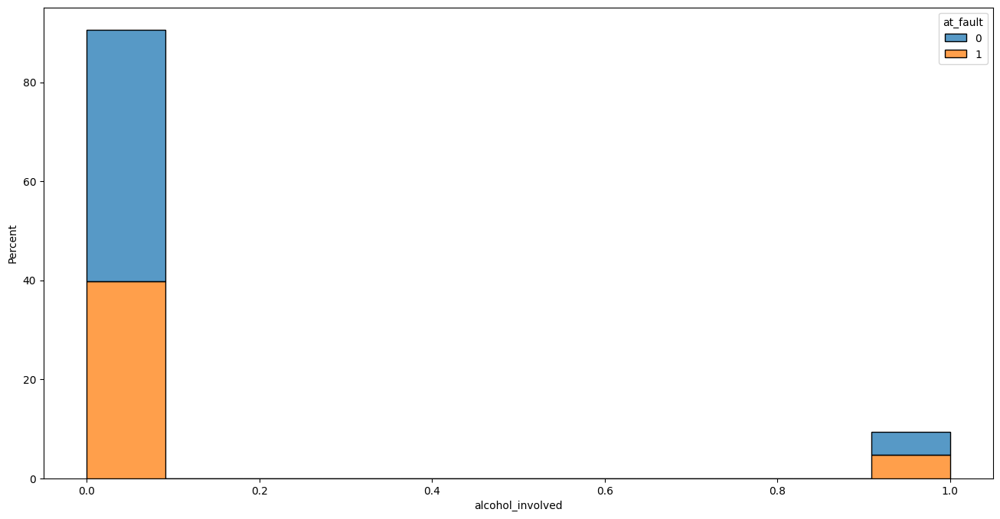

In [26]:
sns.histplot(
    data=data, x="alcohol_involved", hue="at_fault", multiple="stack", stat="percent"
)

In [27]:
data["injured_victims"].value_counts()

injured_victims
0    604
1    264
2     82
3     28
4     14
5      4
7      2
6      2
Name: count, dtype: int64

In [28]:
data["control_device"].value_counts()

control_device
none               653
functioning        339
not functioning      1
obscured             1
Name: count, dtype: int64

In [29]:
data["primary_collision_factor"].value_counts()

primary_collision_factor
vehicle code violation    937
unknown                    35
other than driver          17
other improper driving      3
fell asleep                 2
Name: count, dtype: int64

([0, 1, 2, 3, 4],
 [Text(0, 0, 'daylight'),
  Text(1, 0, 'dark with street lights'),
  Text(2, 0, 'dark with no street lights'),
  Text(3, 0, 'dusk or dawn'),
  Text(4, 0, 'dark with street lights not functioning')])

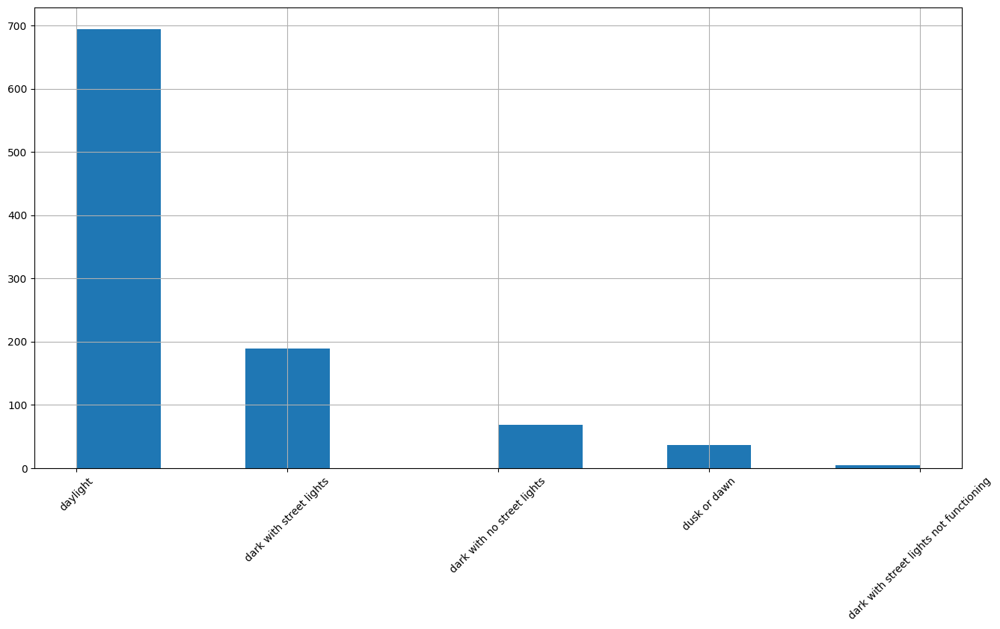

In [30]:
data["lighting"].hist()
plt.xticks(rotation=45)

In [31]:
data["motor_vehicle_involved_with"].value_counts()

motor_vehicle_involved_with
other motor vehicle               714
fixed object                       96
parked motor vehicle               89
bicycle                            36
pedestrian                         26
non-collision                      17
other object                       12
animal                              5
motor vehicle on other roadway      3
Name: count, dtype: int64

In [32]:
data["is_fatal"] = data["killed_victims"] > 0

In [33]:
data["killed_victims"].value_counts()

killed_victims
0    995
1      4
2      1
Name: count, dtype: int64

<Axes: xlabel='motorcycle_collision', ylabel='Percent'>

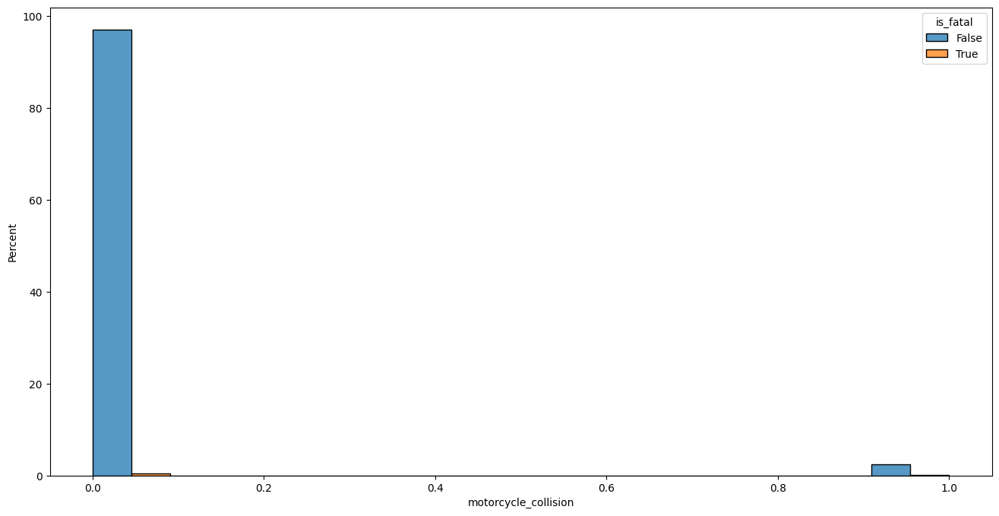

In [34]:
sns.histplot(
    data=data,
    x="motorcycle_collision",
    hue="is_fatal",
    multiple="dodge",
    stat="percent",
)

In [35]:
feature_columns = [
    # qualified as a predictor
    "alcohol_involved",
    # qualified as a predictor - larger damage larger prob to induce fatal accident
    "collision_severity",
    # qualified as a predictor -show that time related predictors are showing patterns
    "collision_date",
    # qualified as a predictor -show that time related predictors are showing patterns
    "collision_time",
    # Should be part of feature importance test - showing if vehicle was controllable in time of accident
    "control_device",
    # this should be transformed as a boolean since most of the data skewed around true/false
    "injured_victims",
    # this is our target variable
    "killed_victims",
    #  # Should be part of feature importance test - could hold time pattern data
    "lighting",
    #  Should be part of feature importance test - participants info could lead to fatal accident
    "motor_vehicle_involved_with",
    # Should be part of feature importance test - could have larger prob
    "motorcycle_collision",
    "pcf_violation_category",
    "pedestrian_action",
    # shown relation between fatal and collision type
    "pedestrian_collision",
    # size of urban area raises probability for a collision
    "population",
    # Should be part of feature importance test - showing what was initial cause of collision
    "primary_collision_factor",
    # Goes together with weather conditions
    "road_surface",
    # shown relation between fatal and collision type
    "truck_collision",
    "type_of_collision",
    # Relevant condition since most of the accidents happen on a dry time,
    # since most people are more careful during poor weather conditions, due to reduced visibility
    "weather_1",
]

## Final plans and Action Items

- Preprocess data: deal with missing data and categorize possible features, thus reducing their complexity
- Use proposed features to derive feature importance tests upon couple of Supervised classification models ( KNN,ANN,RF)
- Tweak the model
- Remove limitations of downsampling and use the whole dataset
- Report the results
- Finish the paper
